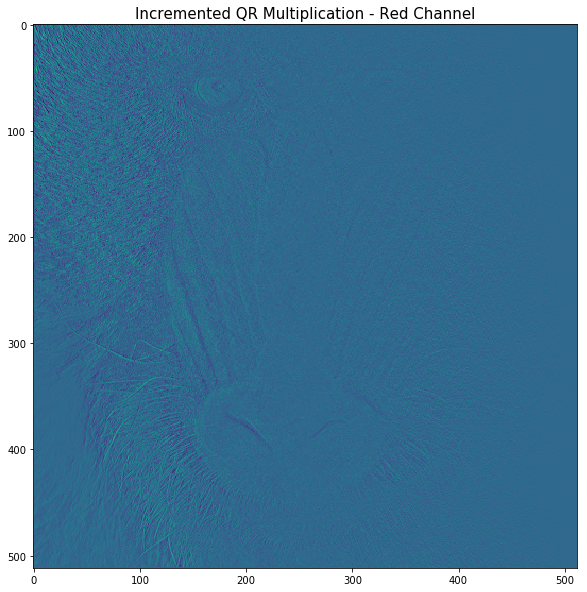

1 th QR Multiplication Pass


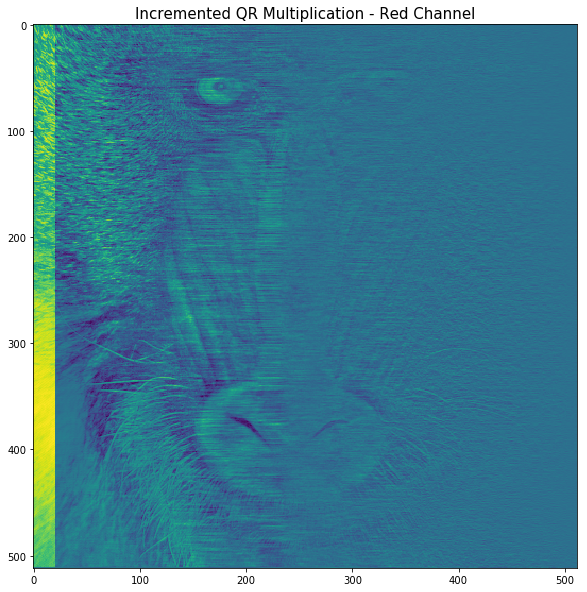

21 th QR Multiplication Pass


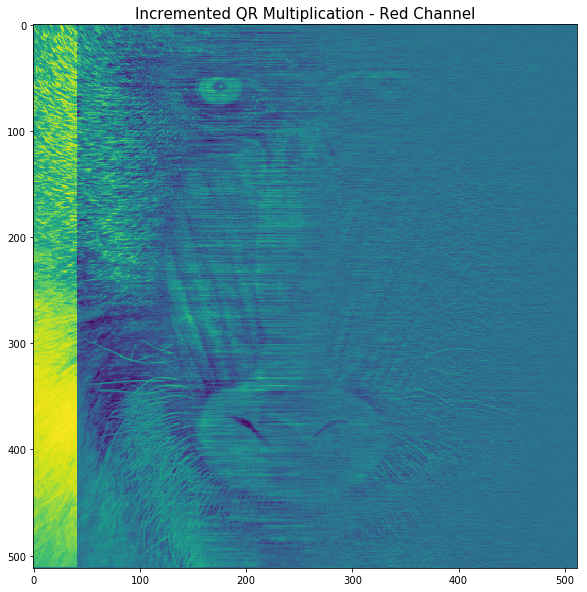

41 th QR Multiplication Pass


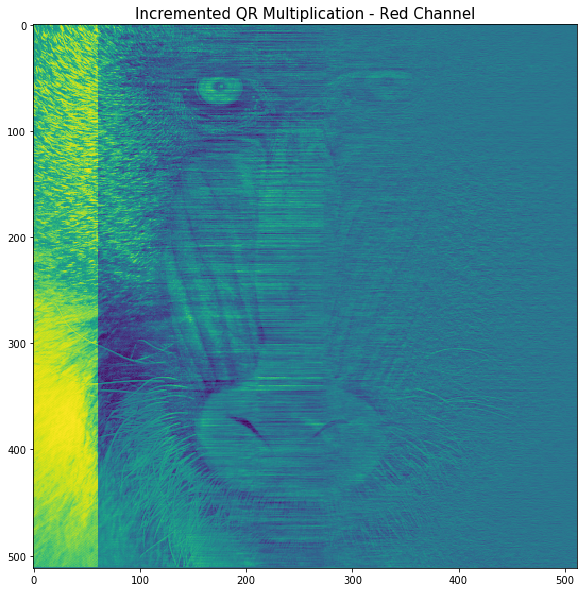

61 th QR Multiplication Pass


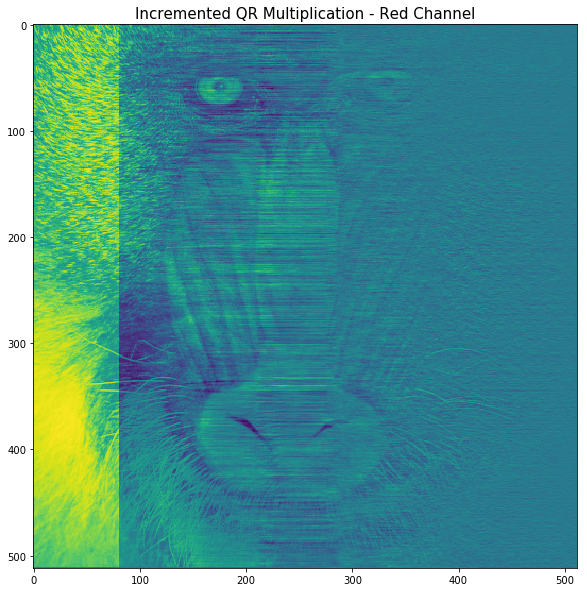

81 th QR Multiplication Pass


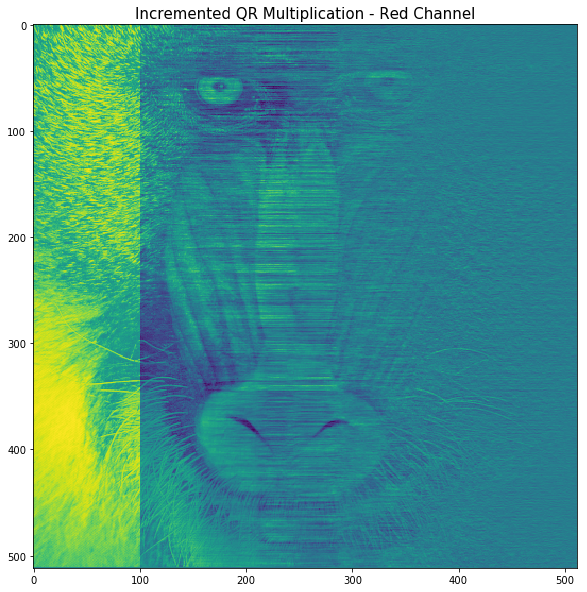

101 th QR Multiplication Pass


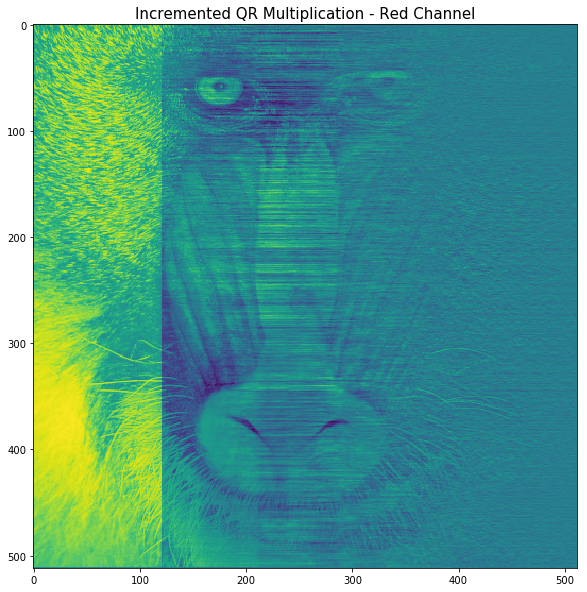

121 th QR Multiplication Pass


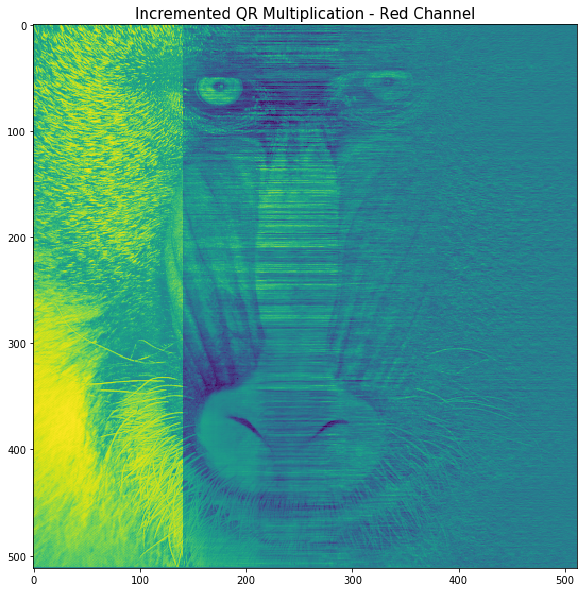

141 th QR Multiplication Pass


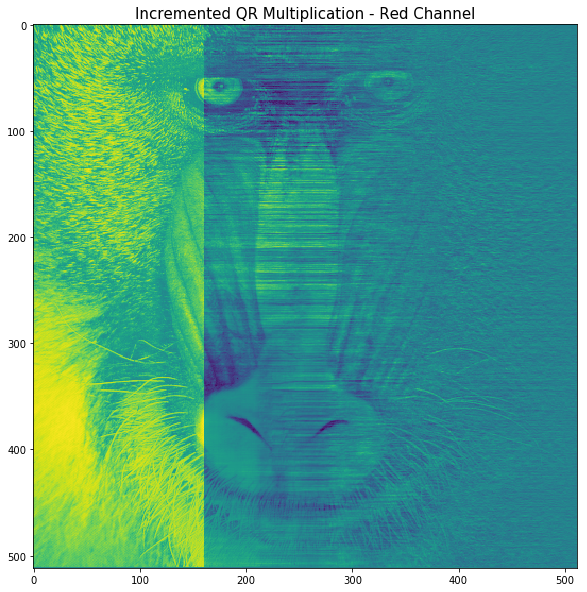

161 th QR Multiplication Pass


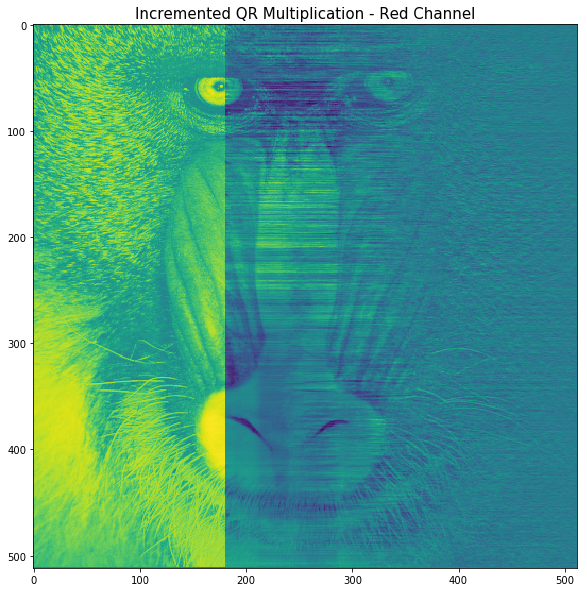

181 th QR Multiplication Pass


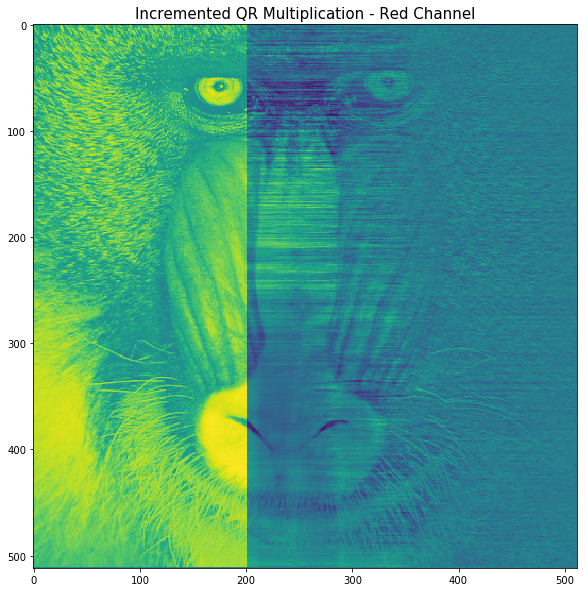

201 th QR Multiplication Pass


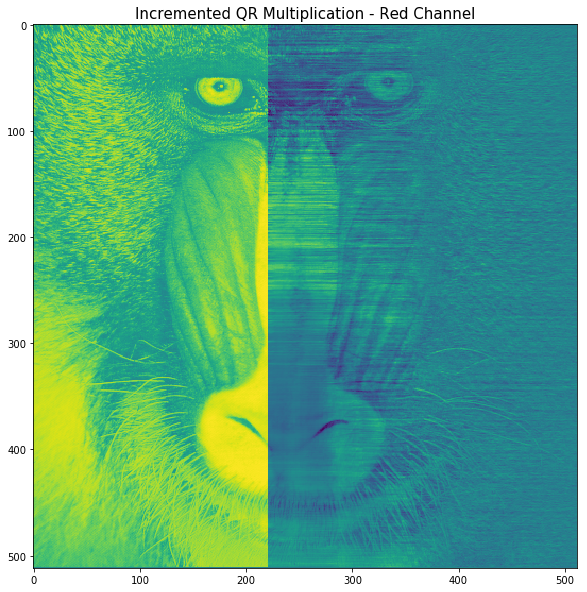

221 th QR Multiplication Pass


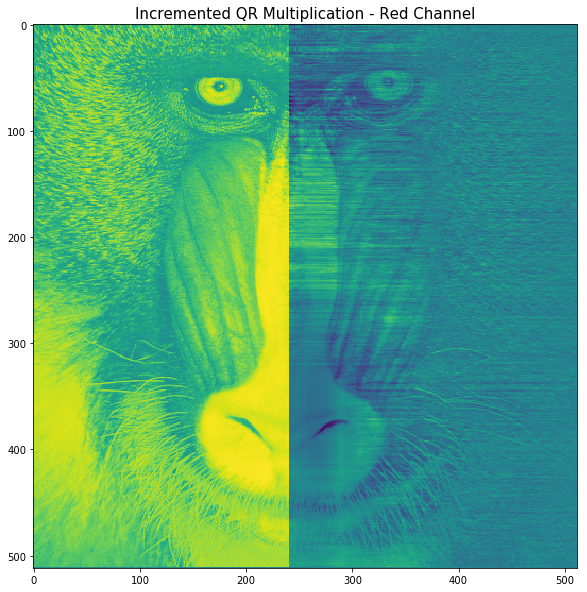

241 th QR Multiplication Pass


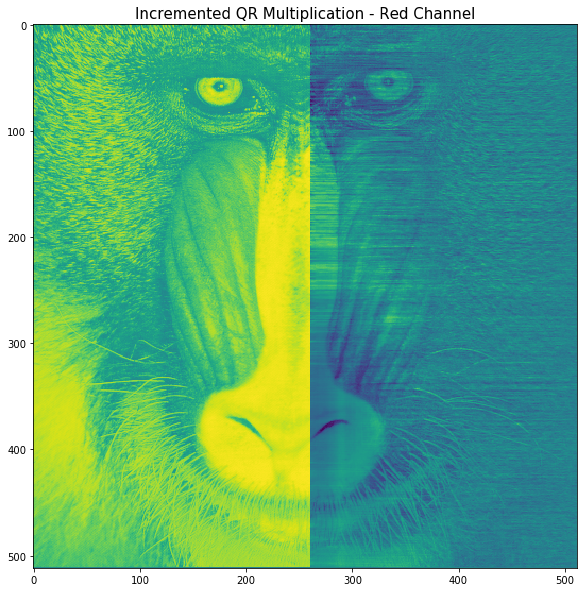

261 th QR Multiplication Pass


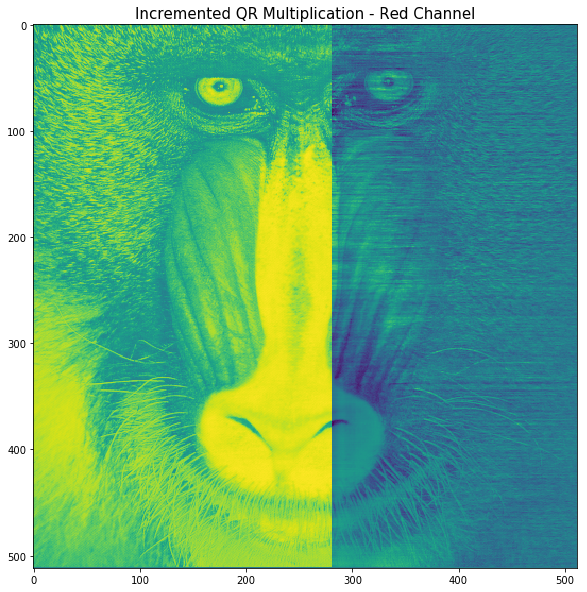

281 th QR Multiplication Pass


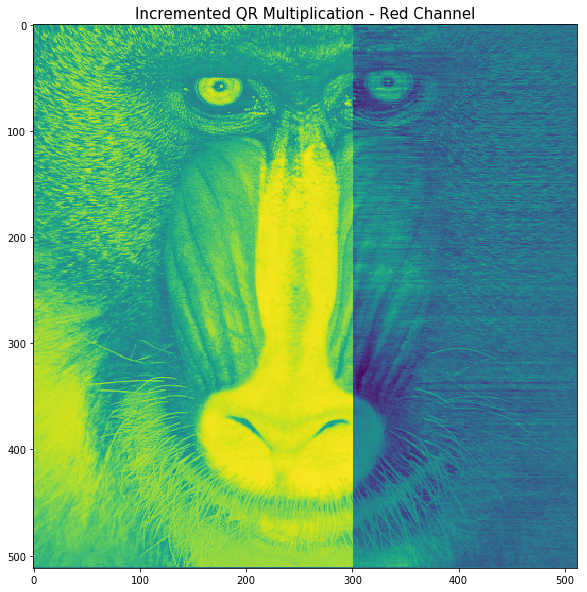

301 th QR Multiplication Pass


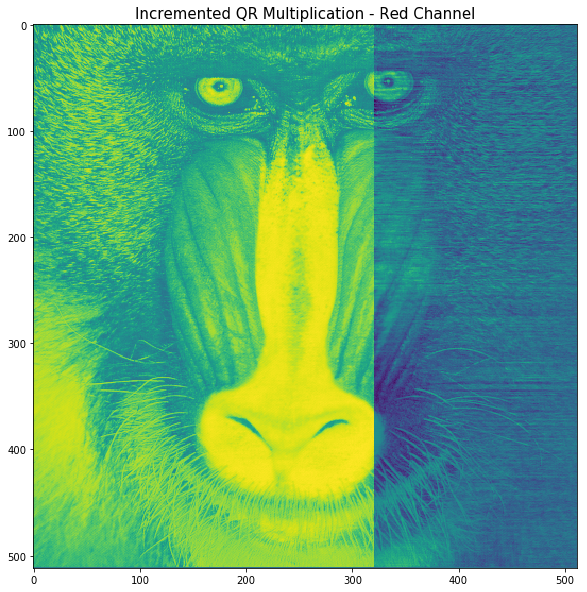

321 th QR Multiplication Pass


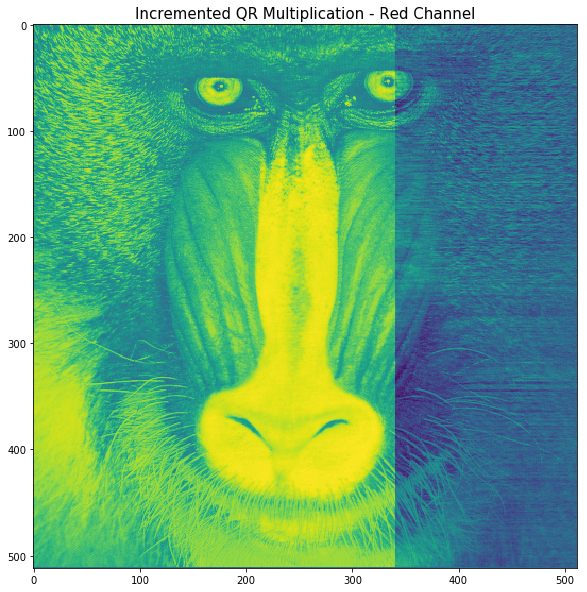

341 th QR Multiplication Pass


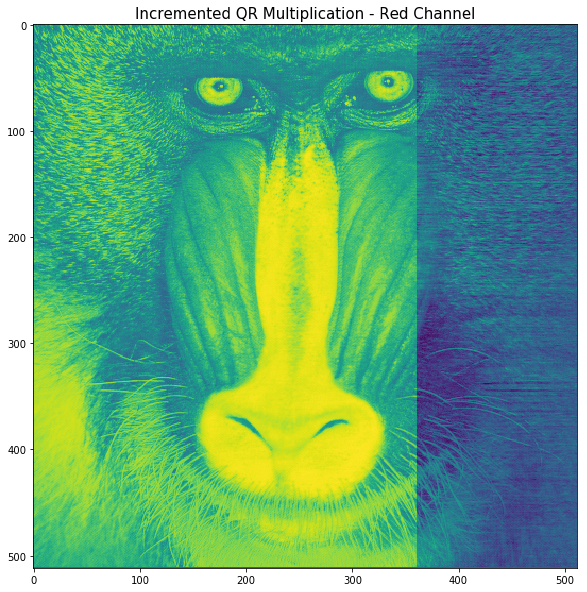

361 th QR Multiplication Pass


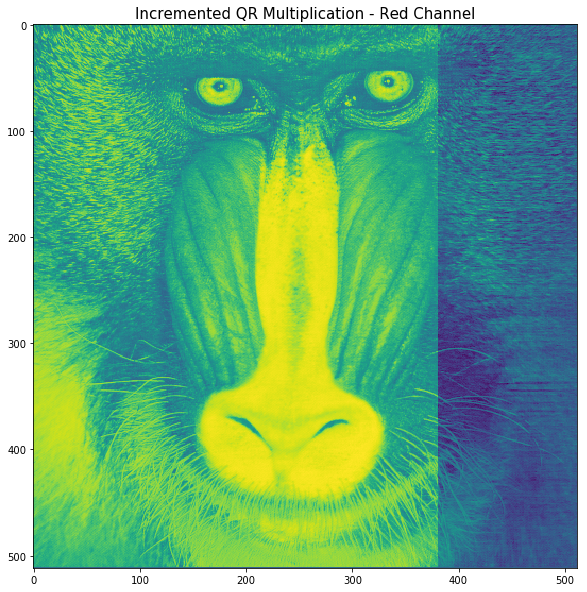

381 th QR Multiplication Pass


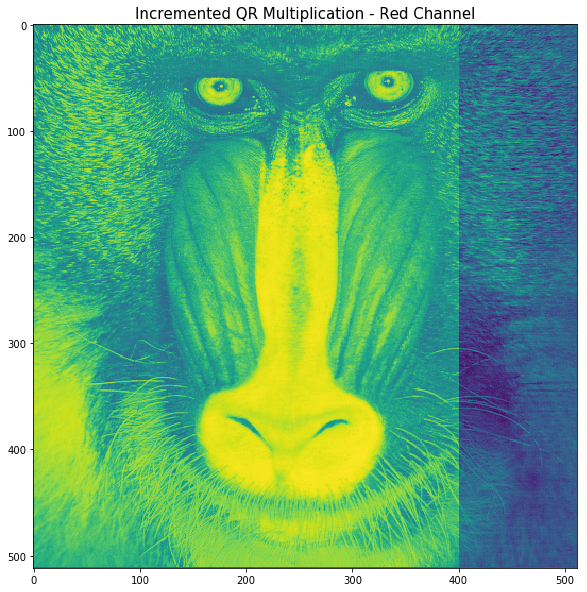

401 th QR Multiplication Pass


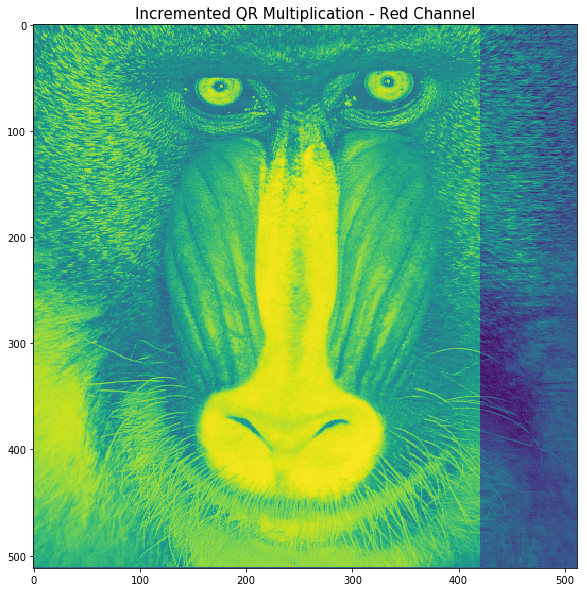

421 th QR Multiplication Pass


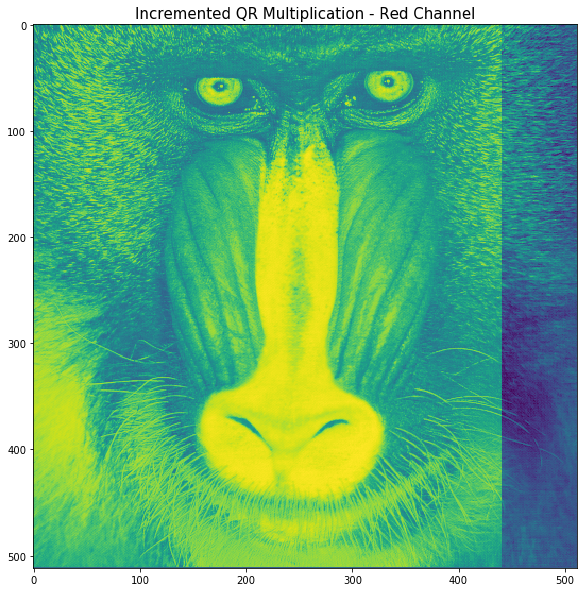

441 th QR Multiplication Pass


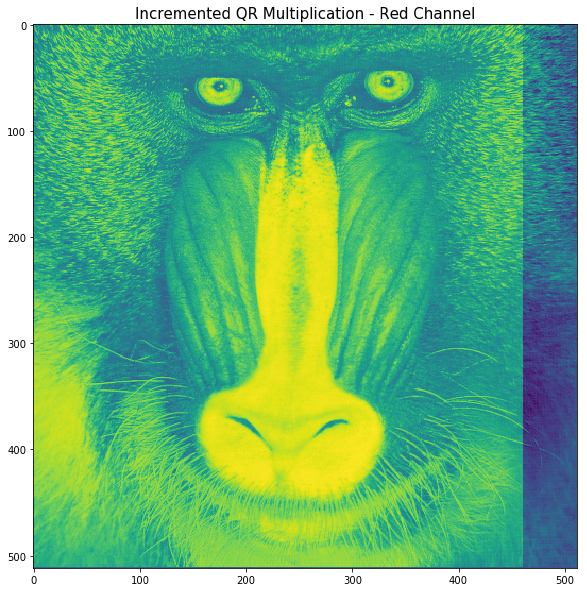

461 th QR Multiplication Pass


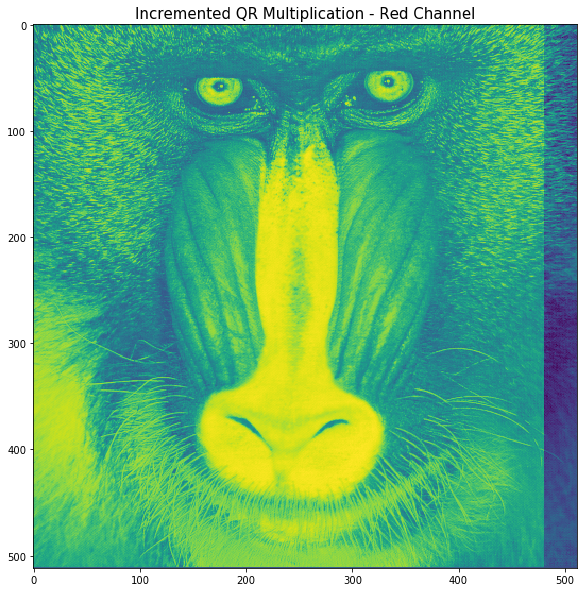

481 th QR Multiplication Pass


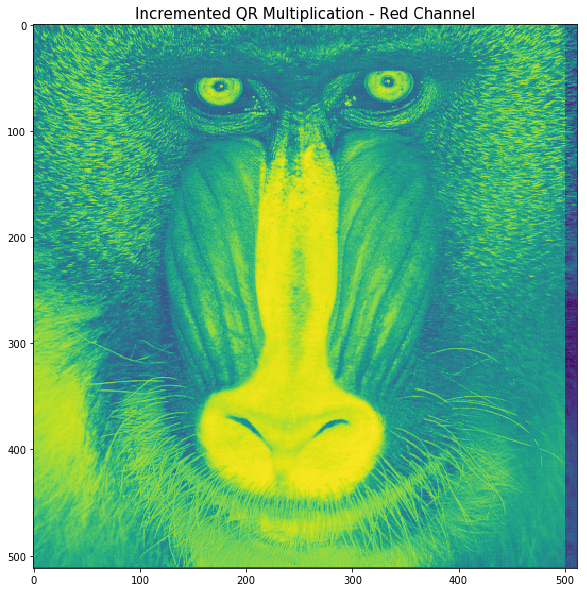

501 th QR Multiplication Pass


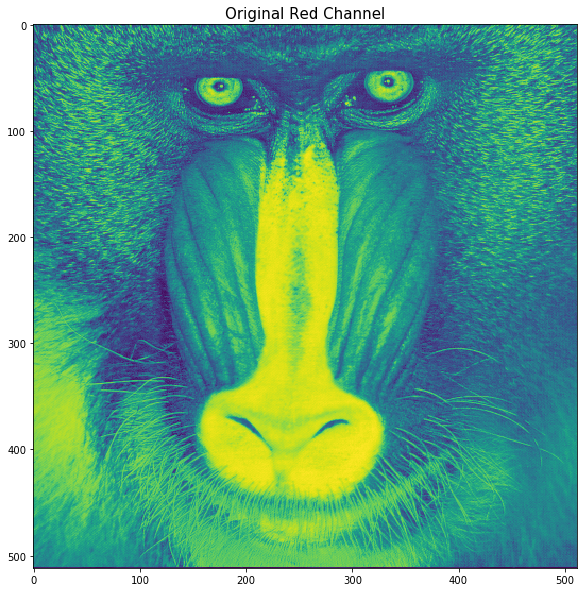


 Test - Compare with Original Red Channel 

False

 Test - Compare (Indexing Isolation) with Original Red Channel 

True

 Incrementing the Red Channel Recreates Approximately, 97.8515625 % of the Original Red Channel 

0.978515625


In [1]:
%matplotlib inline
import numpy as np

from matplotlib.pyplot import *
from pylab import subplots, show
import matplotlib.pyplot as plt

# Sample Image: c_mand_512.tiff - 512 x 512
X = plt.imread('c_mand_512.tiff')

X_copy = X

# Red Channel
Xred = X[:,:,0]

# Green Channel
Xgreen = X[:,:,1]

# Blue Channel
Xblue = X[:,:,2]

n = np.size(Xred[:,0])

####### Red Channel #######

n1 = np.size(Xred[:,0]) # Number of rows in X
n2 = np.size(Xred[0,:]) # Number of columns in X
Qa_red = np.zeros([n1,n2])
Qa_red[:,0] = Xred[:,0]

for j in range(1, n2):
    Qa_red[:,j] = Xred[:,j]
    for i in range(0, j):
        A_red = np.sum(Xred[:,j]*Qa_red[:,i]) / np.sum(Qa_red[:,i]*Qa_red[:,i])  # Dot Product
        Qa_red[:,j] -= A_red*Qa_red[:,i]

Qb_red = np.zeros([n1,n2])
for j in range(0, n2):
    Qb_red[:,j] = Qa_red[:,j] / np.sqrt(np.matmul(np.transpose(Qa_red[:,j]),Qa_red[:,j]))

# The Upper Triangular Matrix - Red Channel
R_red_up = np.matmul(Qb_red.T, Xred)

figs = 10 # figsize
fts = 15 # fontsize

Red_Upper = np.zeros([n1,n2])

# for j in range(500,513):
for j in range(1,513, 20):
    Red_Upper = R_red_up - np.triu(R_red_up,k=j)
    # print(np.round(Red_Upper_j))
    A_red_new = (np.matmul(Qb_red,Red_Upper))
    figure(figsize = (figs,figs))
    plt.imshow(A_red_new)
    plt.title('Incremented QR Multiplication - Red Channel', fontsize = fts)
    plt.show()
    print(j,'th QR Multiplication Pass')

figure(figsize = (figs,figs))
plt.imshow(Xred)
plt.title('Original Red Channel', fontsize = fts)
plt.show()

z = 501 # Test Boundary
#z = 512 # Test Boundary

# Test with original Xred Matrix
print('\n Test - Compare with Original Red Channel \n')
print(np.allclose(Xred,A_red_new))
print('\n Test - Compare (Indexing Isolation) with Original Red Channel \n')
print(np.allclose(Xred[0:z, 0:z],A_red_new[0:z, 0:z]))

percnt = z/512
print('\n Incrementing the Red Channel Recreates Approximately,', percnt*100, '% of the Original Red Channel \n')
print(percnt)

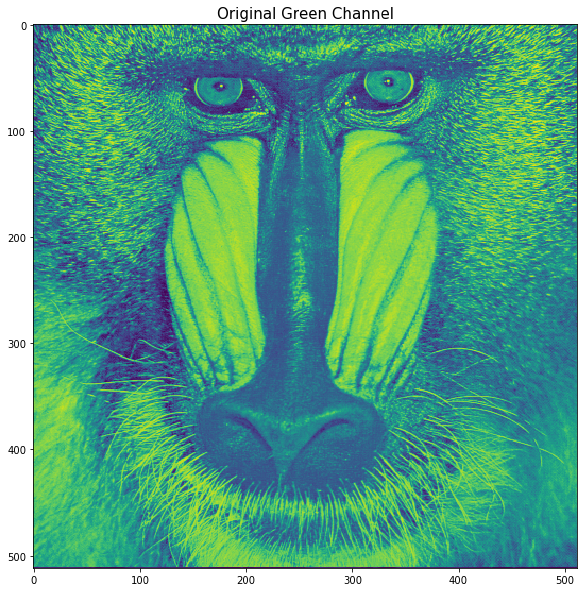


 Test - Compare with Original Green Channel 

False

 Test - Compare (Indexing Isolation) with Original Green Channel 

True

 Incrementing the Green Channel Recreates Approximately, 97.8515625 % of the Original Green Channel 

0.978515625


In [15]:
####### Green Channel #######

n1 = np.size(Xgreen[:,0]) # Number of rows in X
n2 = np.size(Xgreen[0,:]) # Number of columns in X
Qa_green = np.zeros([n1,n2])
Qa_green[:,0] = Xgreen[:,0]

for j in range(1, n2):
    Qa_green[:,j] = Xgreen[:,j]
    for i in range(0, j):
        A_green = np.sum(Xgreen[:,j]*Qa_green[:,i]) / np.sum(Qa_green[:,i]*Qa_green[:,i])  # Dot Product
        Qa_green[:,j] -= A_green*Qa_green[:,i]

Qb_green = np.zeros([n1,n2])
for j in range(0, n2):
    Qb_green[:,j] = Qa_green[:,j] / np.sqrt(np.matmul(np.transpose(Qa_green[:,j]),Qa_green[:,j]))

# The Upper Triangular Matrix - green Channel
R_green_up = np.matmul(Qb_green.T, Xgreen)

figs = 10 # figsize
fts = 15 # fontsize

# for j in range(500,513):
for j in range(1,513, 20):
    green_Upper = R_green_up - np.triu(R_green_up,k=j)
    A_green_new = np.matmul(Qb_green,green_Upper)
    figure(figsize = (figs,figs))
    plt.imshow(A_green_new)
    plt.title('Incremented QR Multiplication - Green Channel', fontsize = fts)
    plt.show()
    print(j,'th QR Multiplication Pass')

figure(figsize = (figs,figs))
plt.imshow(Xgreen)
plt.title('Original Green Channel', fontsize = fts)
plt.show()

z = 501 # Test Boundary
#z = 512 # Test Boundary

# Test with original Xgreen Matrix
print('\n Test - Compare with Original Green Channel \n')
print(np.allclose(Xgreen,A_green_new))

print('\n Test - Compare (Indexing Isolation) with Original Green Channel \n')
print(np.allclose(Xgreen[0:z, 0:z],A_green_new[0:z, 0:z]))

percnt = z/512
print('\n Incrementing the Green Channel Recreates Approximately,', percnt*100, '% of the Original Green Channel \n')
print(percnt)

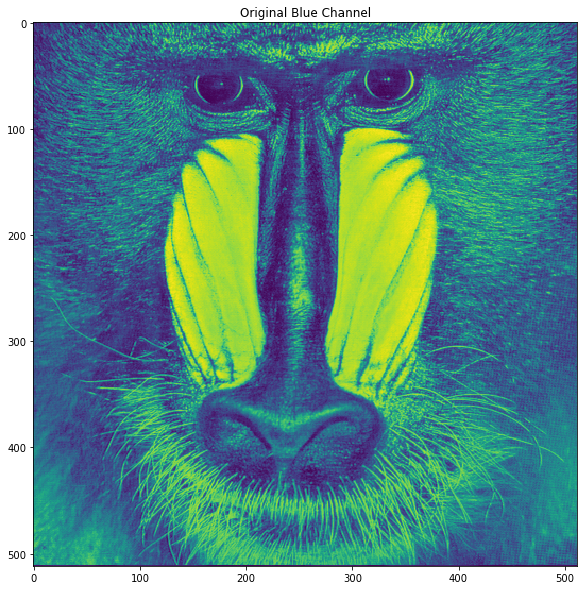


 Test - Compare with Original Blue Channel 

False

 Test - Compare (Indexing Isolation) with Original Blue Channel 

True

 Incrementing the Blue Channel Recreates Approximately, 97.8515625 % of the Original Blue Channel 

0.978515625


In [18]:
####### Blue Channel #######

n1 = np.size(Xblue[:,0]) # Number of rows in X
n2 = np.size(Xblue[0,:]) # Number of columns in X
Qa_blue = np.zeros([n1,n2])
Qa_blue[:,0] = Xblue[:,0]

for j in range(1, n2):
    Qa_blue[:,j] = Xblue[:,j]
    for i in range(0, j):
        A_blue = np.sum(Xblue[:,j]*Qa_blue[:,i]) / np.sum(Qa_blue[:,i]*Qa_blue[:,i])  # Dot Product
        Qa_blue[:,j] -= A_blue*Qa_blue[:,i]

Qb_blue = np.zeros([n1,n2])
for j in range(0, n2):
    Qb_blue[:,j] = Qa_blue[:,j] / np.sqrt(np.matmul(np.transpose(Qa_blue[:,j]),Qa_blue[:,j]))

# The Upper Triangular Matrix - blue Channel
R_blue_up = np.matmul(Qb_blue.T, Xblue)

figs = 10 # figsize
fts = 15 # fontsize

# for j in range(500,513):
for j in range(1,513, 20):
    blue_Upper = R_blue_up - np.triu(R_blue_up,k=j)
    A_blue_new = np.matmul(Qb_blue,blue_Upper)
    figure(figsize = (figs,figs))
    plt.imshow(A_blue_new)
    plt.title('Incremented QR Multiplication - Blue Channel', fontsize = fts)
    plt.show()
    print(j,'th QR Multiplication Pass')

figure(figsize = (figs,figs))
plt.imshow(Xblue)
plt.title('Original Blue Channel')
plt.show()

z = 501 # Test Boundary
#z = 512 # Test Boundary

# Test with original Xblue Matrix
print('\n Test - Compare with Original Blue Channel \n')
print(np.allclose(Xblue,A_blue_new))

print('\n Test - Compare (Indexing Isolation) with Original Blue Channel \n')
print(np.allclose(Xblue[0:z, 0:z],A_blue_new[0:z, 0:z]))

percnt = z/512
print('\n Incrementing the Blue Channel Recreates Approximately,', percnt*100, '% of the Original Blue Channel \n')
print(percnt)

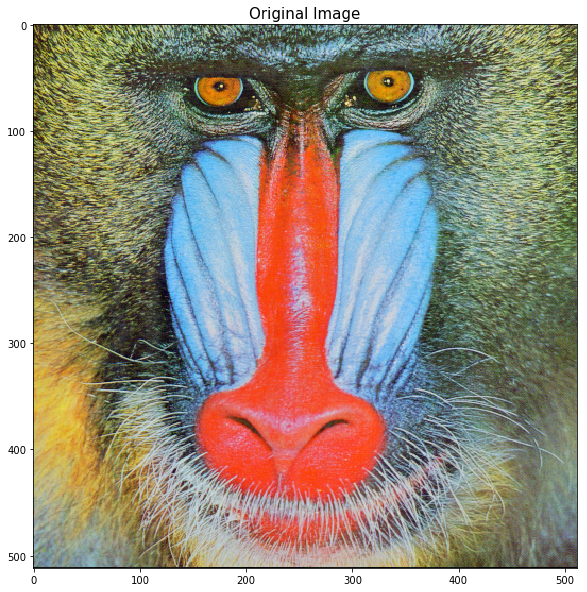

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


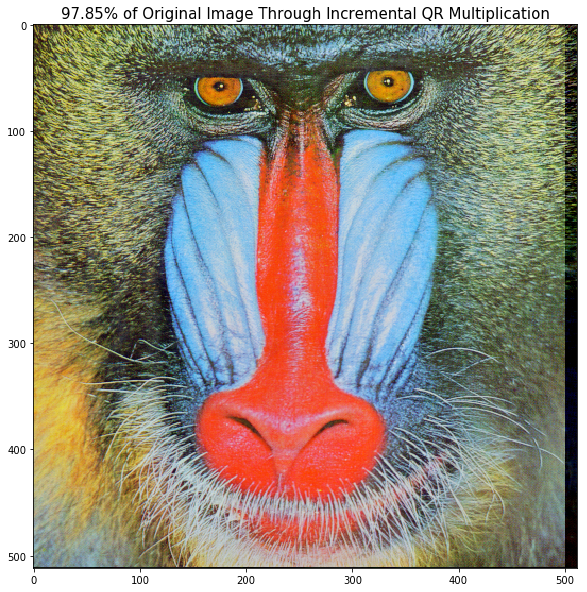

In [40]:
figs = 10 # figsize
fts = 15 # fontsize

figure(figsize = (figs,figs))
plt.imshow(X)
plt.title('Original Image', fontsize = fts)
plt.show()

figure(figsize = (figs,figs))
XRGB = np.dstack((A_red_new,A_green_new,A_blue_new))
plt.imshow(XRGB/255)
plt.title('97.85% of Original Image Through Incremental QR Multiplication', fontsize = fts)
plt.show()